In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from scipy.io import loadmat, savemat
from scipy.stats import f_oneway

In [2]:
##all the sessions data of MEG
data1=loadmat("../../Database_PWelch_AvgTrials_MI_Baseline_RS1_19Subjects_MEG_Sess1.mat")
data2=loadmat("../../Database_PWelch_AvgTrials_MI_Baseline_RS1_19Subjects_MEG_Sess2.mat")
data3=loadmat("../../Database_PWelch_AvgTrials_MI_Baseline_RS1_19Subjects_MEG_Sess3.mat")
data4=loadmat("../../Database_PWelch_AvgTrials_MI_Baseline_RS1_19Subjects_MEG_Sess4.mat")

##all the sessions mi 
sess1_mi_avg=data1['Avg_MI_MEG_DK']
sess2_mi_avg=data2['Avg_MI_MEG_DK']
sess3_mi_avg=data3['Avg_MI_MEG_DK']
sess4_mi_avg=data4['Avg_MI_EEG_DK']

##all the sessions resting state
sess1_rest_avg=data1['Avg_RS1_MEG_DK']
sess2_rest_avg=data2['Avg_RS1_MEG_DK']
sess3_rest_avg=data3['Avg_RS1_MEG_DK']
sess4_rest_avg=data4['Avg_RS1_EEG_DK']

##all the sessions baseline
sess1_base_avg=data1['Avg_Baseline_MEG_DK']
sess2_base_avg=data2['Avg_Baseline_MEG_DK']
sess3_base_avg=data3['Avg_Baseline_MEG_DK']
sess4_base_avg=data4['Avg_Baseline_EEG_DK']

In [3]:
sess1_mi_avg.shape

(19, 68, 126)

In [7]:
df=pd.read_excel('../ListROIs_DK.xlsx')
fvec=np.squeeze(data1["Freqs"])[3:30]

In [8]:
all_regions=[]
all_regions_idx=[]
for i,r in df.iterrows():
    all_regions_idx.append(i)
    all_regions.append(r['ROI'].strip("'"))

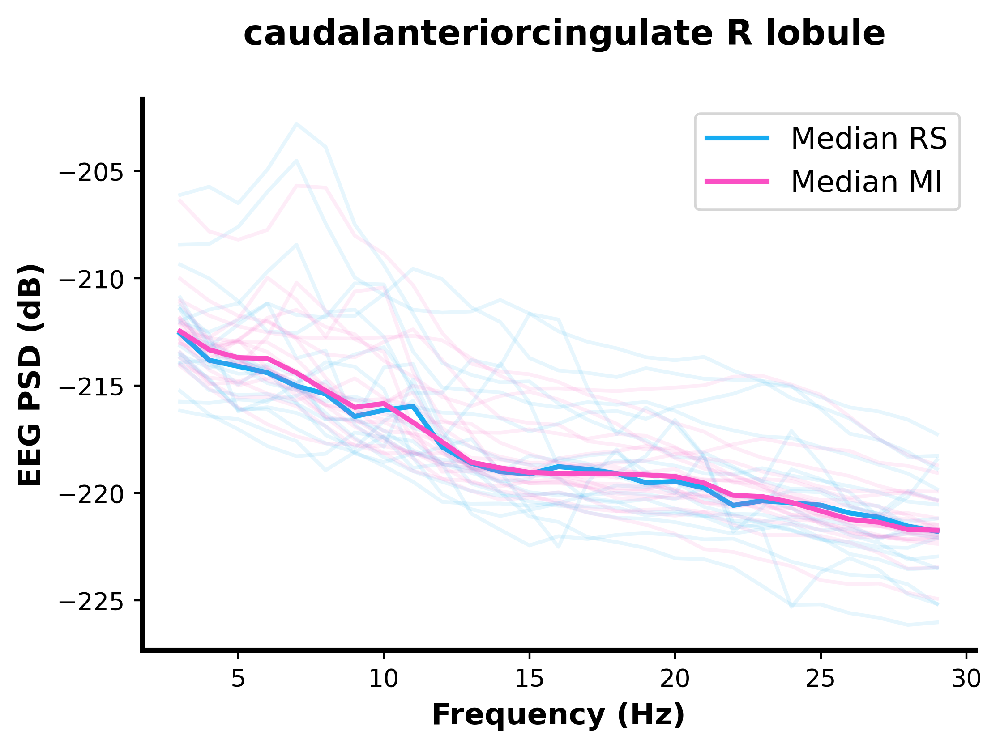

In [11]:
#plotting median spectra
col_rs = "#16ACF2" 
col_mi = "#FA50C4" 

fig, ax = plt.subplots(1, 1, figsize=(6, 4), dpi=400)

region=all_regions[3]
#individual spectra
for i in range(19):
    ax.plot(fvec, 10*np.log10(sess4_rest_avg[i, 3, 3:30]), color=col_rs, alpha=0.1)
#median spectrum
spectra_eeg_rs1 = 10*np.log10(np.median(sess4_rest_avg[:, 3, 3:30], axis=0))
ax.plot(fvec, spectra_eeg_rs1, color=col_rs, label='Median RS', linewidth=2)

#individual spectra
for i in range(19):
    ax.plot(fvec, 10*np.log10(sess4_mi_avg[i, 3, 3:30]), color=col_mi, alpha=0.1)
#median spectrum 
spectra_eeg_mi = 10*np.log10(np.median(sess4_mi_avg[:, 3, 3:30], axis=0))
ax.plot(fvec, spectra_eeg_mi, color=col_mi, label='Median MI', linewidth=2)

ax.set_title(f' {region} lobule\n', fontweight='bold', fontsize=14)
ax.set_xlabel('Frequency (Hz)',fontweight='bold', fontsize=12)
ax.set_ylabel('EEG PSD (dB)',fontweight='bold', fontsize=12)
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.spines['bottom'].set_linewidth(2)
ax.spines['bottom'].set_color('black')
ax.spines['left'].set_linewidth(2)
ax.spines['left'].set_color('black')
ax.legend(fontsize=12)
ax.grid(False)

plt.show()

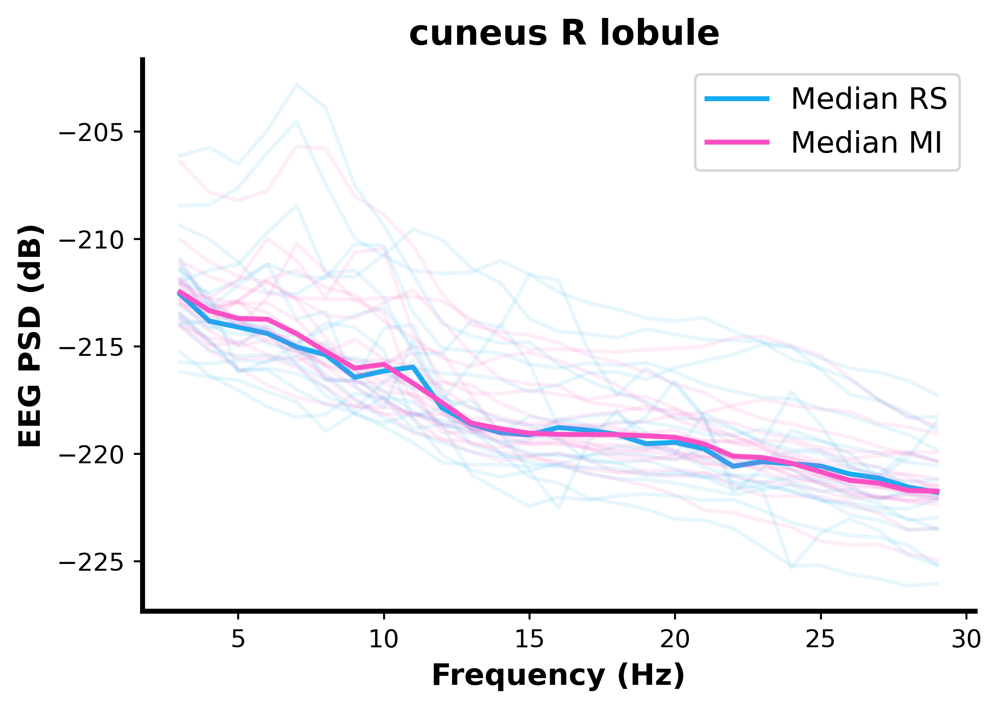

In [12]:
#plotting median spectra
col_rs = "#16ACF2" 
col_mi = "#FA50C4" 

fig, ax = plt.subplots(1, 1, figsize=(6, 4), dpi=400)

region=all_regions[7]
#individual spectra
for i in range(19):
    ax.plot(fvec, 10*np.log10(sess4_rest_avg[i, 3, 3:30]), color=col_rs, alpha=0.1)
#median spectrum
spectra_eeg_rs1 = 10*np.log10(np.median(sess4_rest_avg[:, 3, 3:30], axis=0))
ax.plot(fvec, spectra_eeg_rs1, color=col_rs, label='Median RS', linewidth=2)

#individual spectra
for i in range(19):
    ax.plot(fvec, 10*np.log10(sess4_mi_avg[i, 3, 3:30]), color=col_mi, alpha=0.1)
#median spectrum 
spectra_eeg_mi = 10*np.log10(np.median(sess4_mi_avg[:, 3, 3:30], axis=0))
ax.plot(fvec, spectra_eeg_mi, color=col_mi, label='Median MI', linewidth=2)

ax.set_title(f' {region} lobule', fontweight='bold', fontsize=14)
ax.set_xlabel('Frequency (Hz)',fontweight='bold', fontsize=12)
ax.set_ylabel('EEG PSD (dB)',fontweight='bold', fontsize=12)
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.spines['bottom'].set_linewidth(2)
ax.spines['bottom'].set_color('black')
ax.spines['left'].set_linewidth(2)
ax.spines['left'].set_color('black')
ax.legend(fontsize=12)
ax.grid(False)

plt.show()

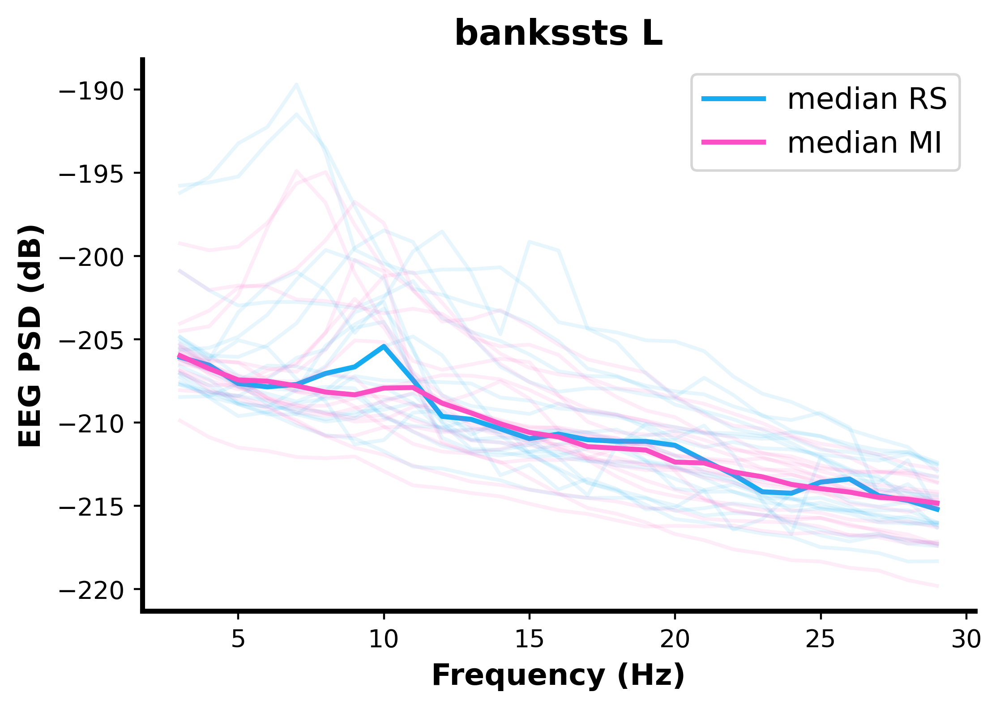

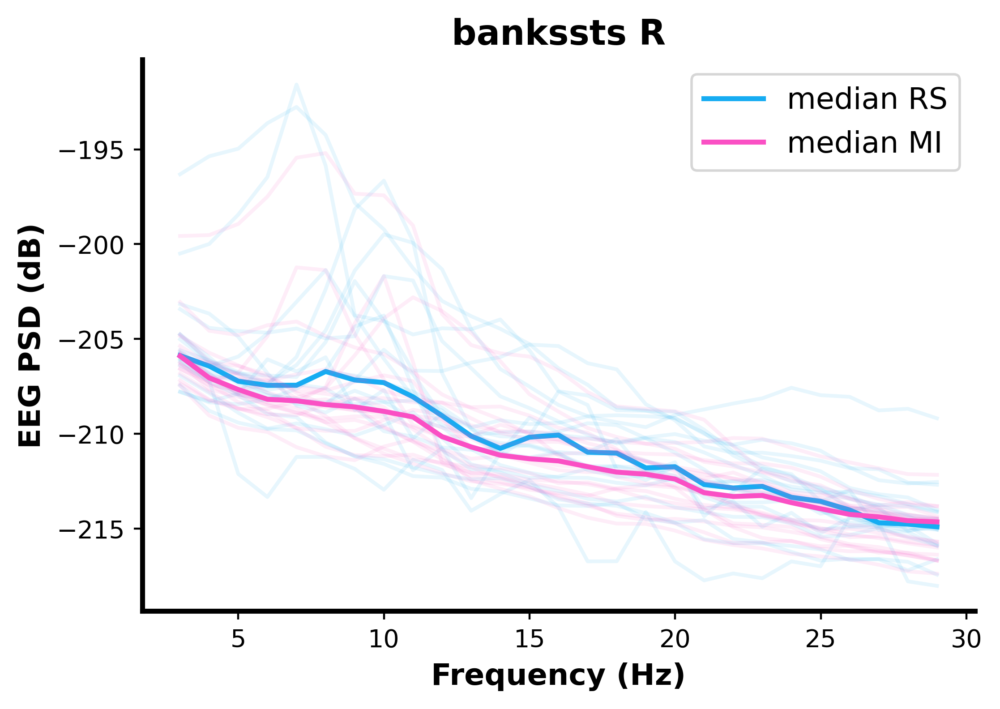

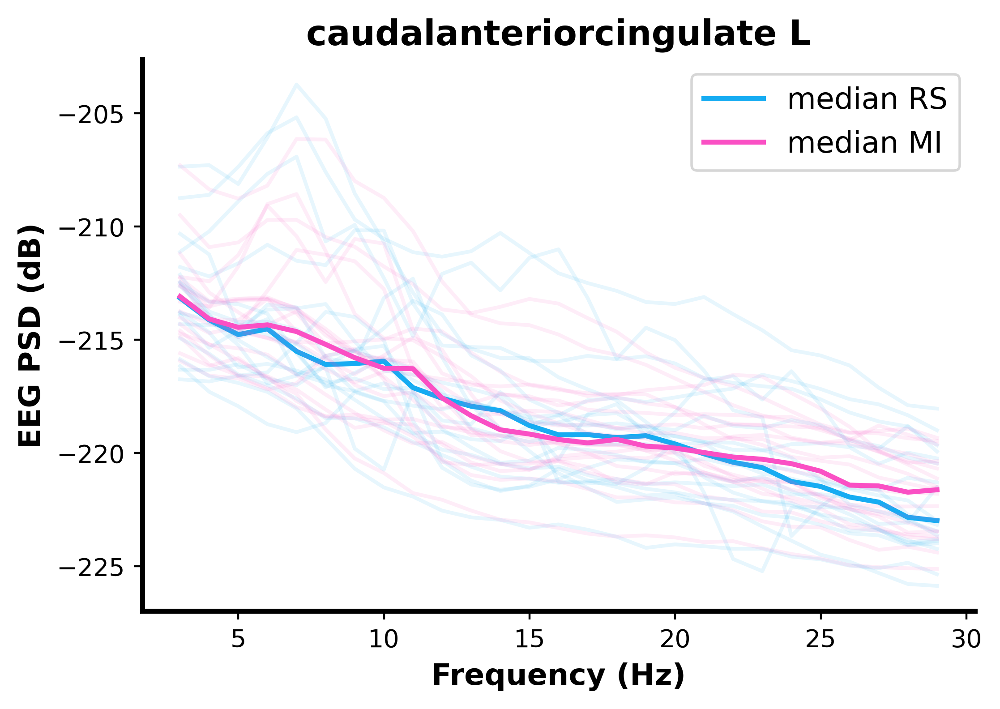

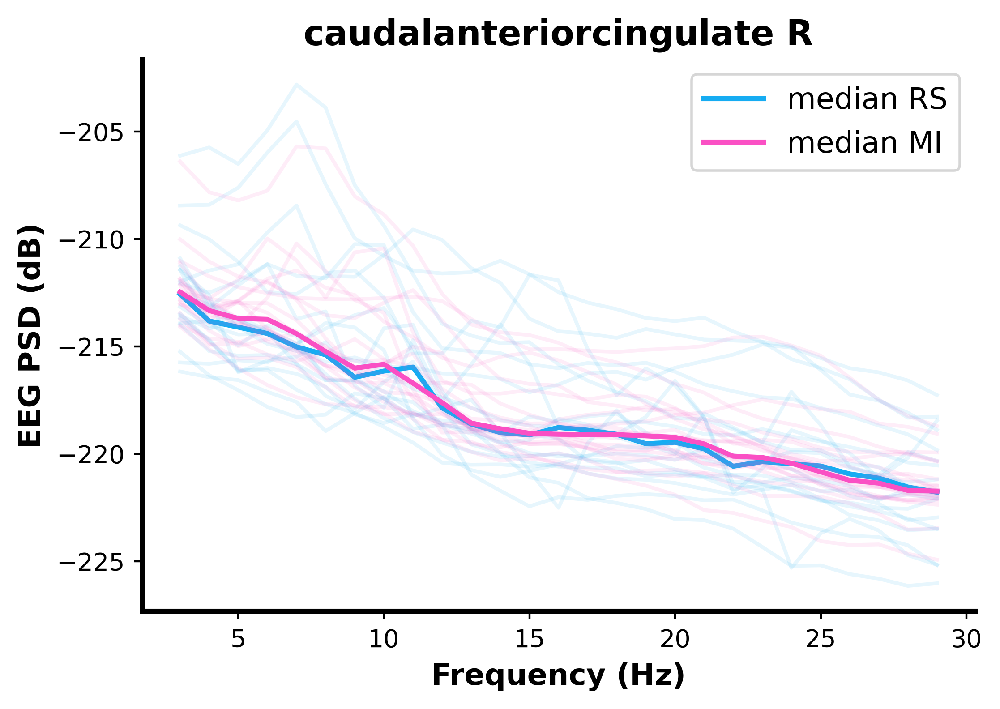

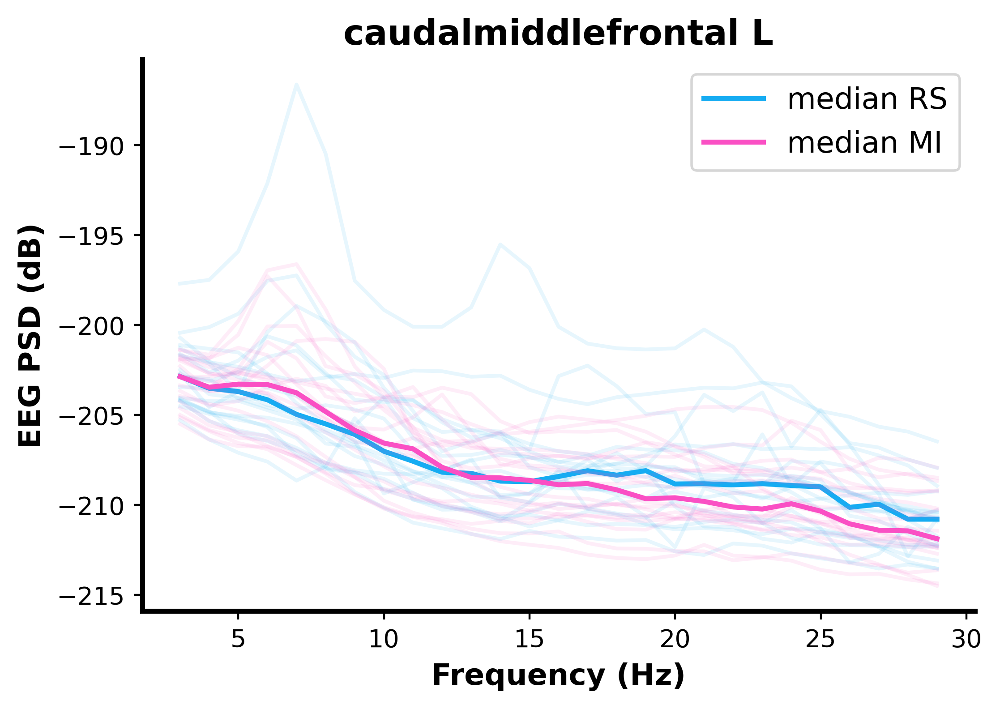

...

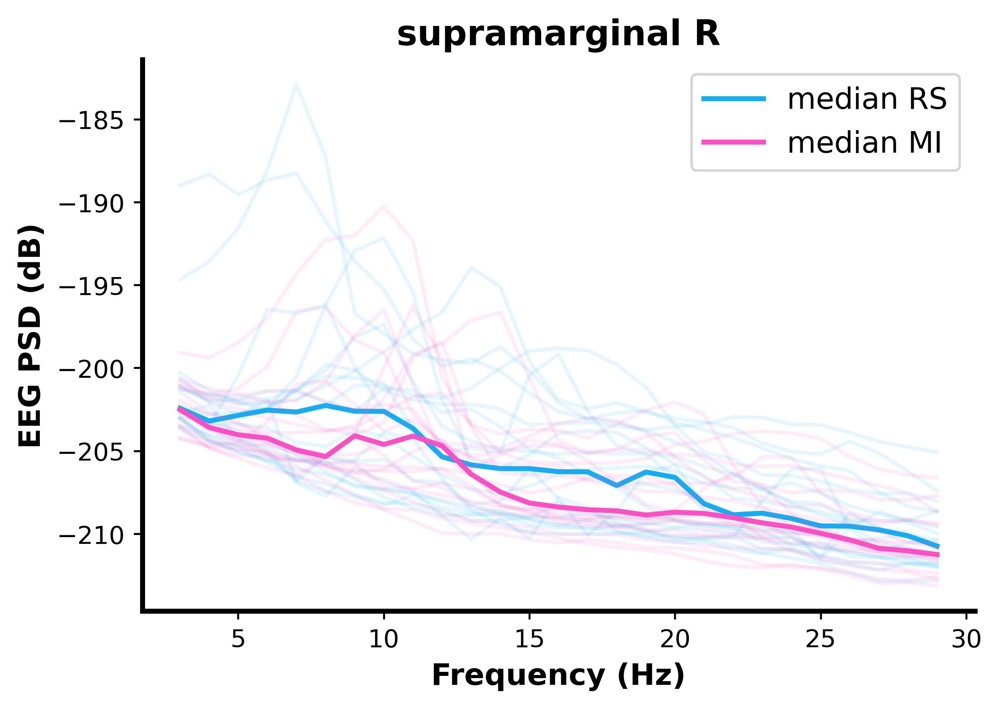

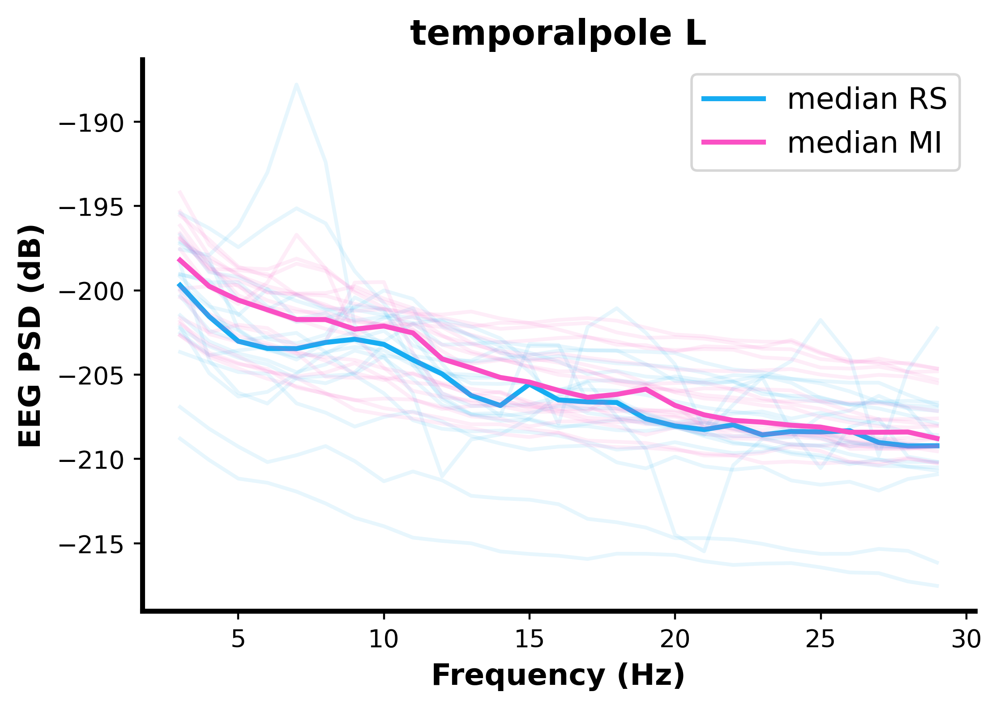

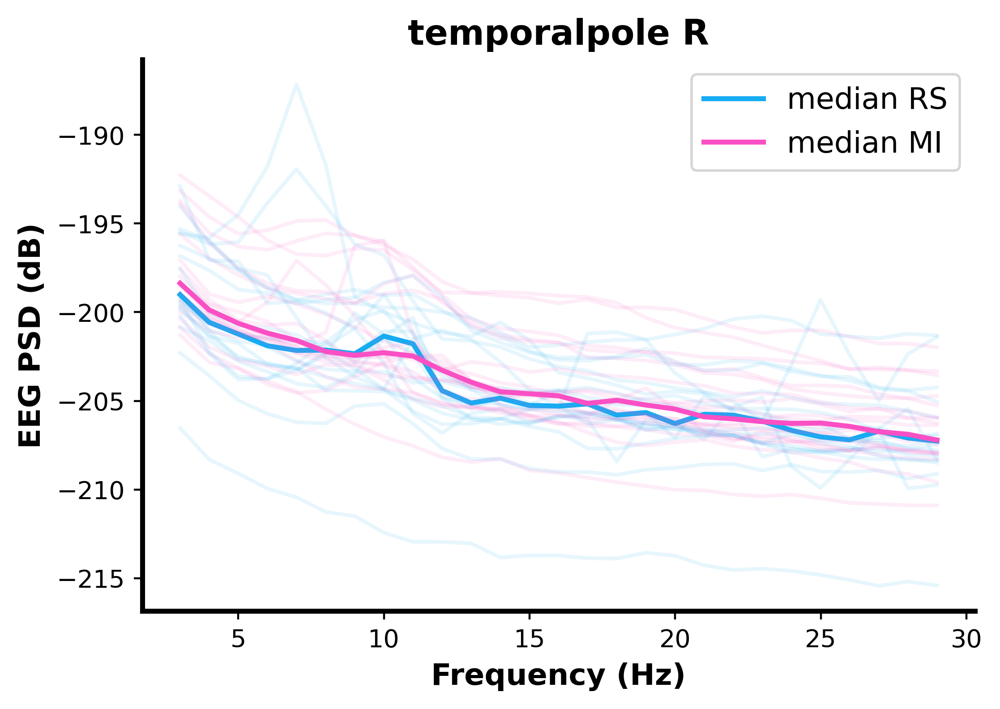

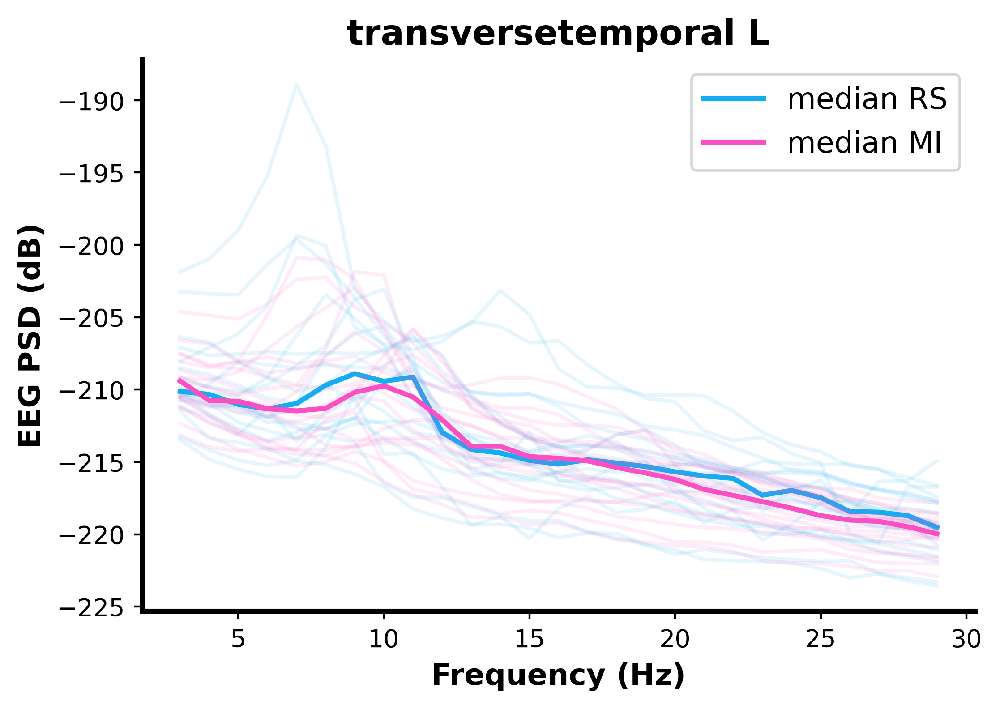

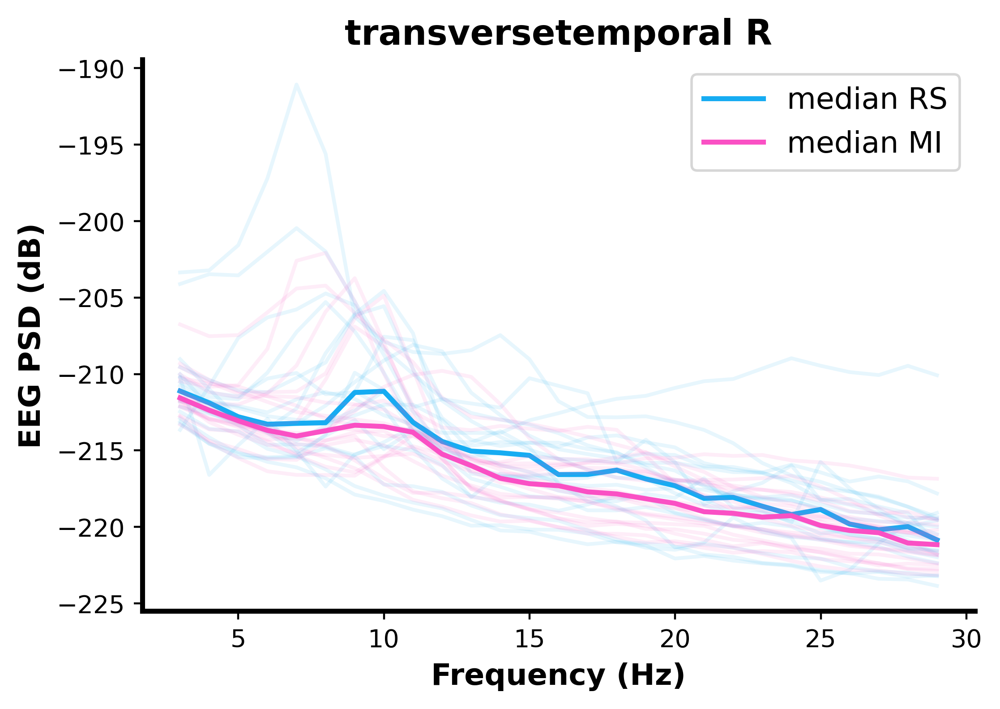

In [13]:
#plotting median spectra
col_rs = "#16ACF2" 
col_mi = "#FA50C4" 

for region in range(68):
    fig, ax = plt.subplots(1, 1, figsize=(6, 4), dpi=400)
    for i in range(19):
        ax.plot(fvec, 10*np.log10(sess4_rest_avg[i, region, 3:30]), color=col_rs, alpha=0.1)
    #median spectrum
    spectra_eeg_rs1 = 10*np.log10(np.median(sess4_rest_avg[:, region, 3:30], axis=0))
    ax.plot(fvec, spectra_eeg_rs1, color=col_rs, label='median RS', linewidth=2)

    #individual spectra
    for i in range(19):
        ax.plot(fvec, 10*np.log10(sess4_mi_avg[i, region, 3:30]), color=col_mi, alpha=0.1)
    #median spectrum 
    spectra_eeg_mi = 10*np.log10(np.median(sess4_mi_avg[:, region, 3:30], axis=0))
    ax.plot(fvec, spectra_eeg_mi, color=col_mi, label='median MI', linewidth=2)

    ax.set_title(f'{all_regions[region]}', fontweight='bold', fontsize=14)
    ax.set_xlabel('Frequency (Hz)',fontweight='bold', fontsize=12)
    ax.set_ylabel('EEG PSD (dB)',fontweight='bold', fontsize=12)
    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)
    ax.spines['bottom'].set_linewidth(2)
    ax.spines['bottom'].set_color('black')
    ax.spines['left'].set_linewidth(2)
    ax.spines['left'].set_color('black')
    ax.legend(fontsize=12)
    ax.grid(False)

    plt.show()

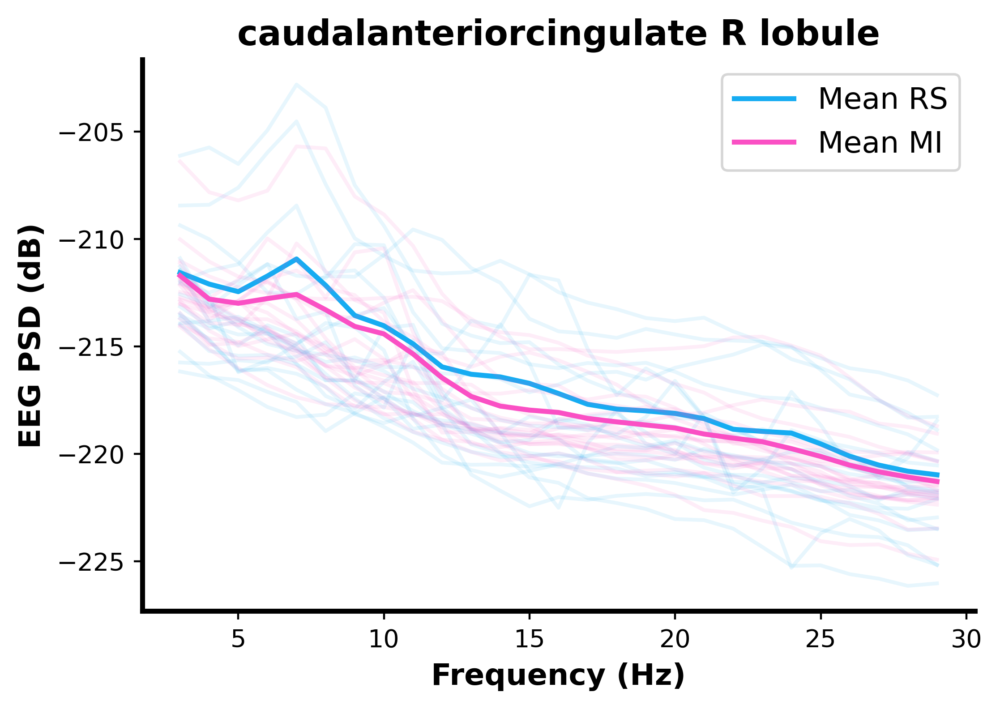

In [14]:
#plotting mean spectra
col_rs = "#16ACF2" 
col_mi = "#FA50C4" 

fig, ax = plt.subplots(1, 1, figsize=(6, 4), dpi=400)

region=all_regions[3]
#individual spectra
for i in range(19):
    ax.plot(fvec, 10*np.log10(sess4_rest_avg[i, 3, 3:30]), color=col_rs, alpha=0.1)
#mean spectrum
spectra_eeg_rs1 = 10*np.log10(np.mean(sess4_rest_avg[:, 3, 3:30], axis=0))
ax.plot(fvec, spectra_eeg_rs1, color=col_rs, label='Mean RS', linewidth=2)

#individual spectra
for i in range(19):
    ax.plot(fvec, 10*np.log10(sess4_mi_avg[i, 3, 3:30]), color=col_mi, alpha=0.1)
#mean spectrum 
spectra_eeg_mi = 10*np.log10(np.mean(sess4_mi_avg[:, 3, 3:30], axis=0))
ax.plot(fvec, spectra_eeg_mi, color=col_mi, label='Mean MI', linewidth=2)

ax.set_title(f'{region} lobule', fontweight='bold', fontsize=14)
ax.set_xlabel('Frequency (Hz)',fontweight='bold', fontsize=12)
ax.set_ylabel('EEG PSD (dB)',fontweight='bold', fontsize=12)
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.spines['bottom'].set_linewidth(2)
ax.spines['bottom'].set_color('black')
ax.spines['left'].set_linewidth(2)
ax.spines['left'].set_color('black')
ax.legend(fontsize=12)
ax.grid(False)

plt.show()